In [ ]:
!pip install -r requirements.txt

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 422.2/422.2 kB 5.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 750.6/750.6 MB 1.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 354.1/354.1 kB 39.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.3/139.3 kB 19.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 82.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.2/98.2 MB 8.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 15.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.2/57.2 kB 8.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 10.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.1/12.1 MB 88.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 84.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 77.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━

In [ ]:
import warnings
import gdown
import pandas as pd
import numpy as np
from copy import deepcopy
import matplotlib.pyplot as plt
import pandas as pd
from etna.analysis import cross_corr_plot
from etna.analysis import distribution_plot
from etna.analysis import plot_anomalies
from etna.analysis import plot_backtest
from etna.analysis import plot_anomalies_interactive
from etna.analysis import plot_correlation_matrix
from etna.analysis import plot_forecast
from etna.analysis import acf_plot
from etna.analysis.outliers import get_anomalies_density
from etna.analysis.outliers import get_anomalies_hist
from etna.analysis.outliers import get_anomalies_median
from etna.analysis.outliers import get_anomalies_prediction_interval
from etna.datasets import TSDataset
from etna.ensembles import DirectEnsemble, StackingEnsemble, VotingEnsemble
from etna.metrics import MAE, MAPE, MSE, SMAPE
from etna.models import CatBoostPerSegmentModel
from etna.models import CatBoostMultiSegmentModel
from etna.models import LinearPerSegmentModel
from etna.models import MovingAverageModel
from etna.models import NaiveModel
from etna.models import AutoARIMAModel
from etna.models import ProphetModel
from etna.models import SeasonalMovingAverageModel
from etna.pipeline import AutoRegressivePipeline, Pipeline, assemble_pipelines
from etna.transforms import DateFlagsTransform
from etna.transforms import FilterFeaturesTransform
from etna.transforms import HolidayTransform
from etna.transforms import LagTransform
from etna.transforms import LinearTrendTransform
from etna.transforms import LogTransform
from etna.transforms import MeanTransform
from etna.transforms import MedianOutliersTransform
from etna.transforms import DensityOutliersTransform
from etna.transforms import SegmentEncoderTransform
from etna.transforms import TimeSeriesImputerTransform
from etna.analysis import plot_trend
from ruptures.detection import Binseg
from etna.analysis import find_change_points
from etna.analysis import plot_change_points_interactive
from etna.analysis import plot_time_series_with_change_points
from etna.pipeline import Pipeline
from etna.models import ProphetModel

warnings.filterwarnings("ignore")

В данной задаче мы будем решать одну из актуальных практических задач, с которыми, в том числе, сталкиваются разработчики ETNA - прогнозирование объема необходимой наличности в банкоматах. Пожалуй, ни для кого не секрет, что отсутствие необходимой суммы в банкомате не делает клиента банка счастливее. В то же время, избыток заправленной в банкомат наличности приводит к упущенной выгоде - ведь, в конечном счете, эти деньги могли быть размещены в качестве краткосрочного депозита на межбанковском рынке. Для кредитной организации с обширной сетью банкоматов даже незначительное улучшение качества предсказания способно внести значительный вклад в прибыльность этой ветки бизнеса.

В качестве инструмента воспользуемся библиотекой ETNA, документацию можно прочитать [тут](https://docs.etna.ai/stable/), и [чат](https://t.me/etna_support) комьюнити.

Мы будем использовать дневные данные реальных банкоматов для чего возьмем мультисегментный датасет.

In [ ]:
url = 'https://gist.githubusercontent.com/Polzovat123/4d6d5e544e93429c2d3db29196e9c918/raw/24b27e60f587128d71678e267f51cd48472c6a84/atms_daily_cash.csv'
output = 'atms_daily_cash.csv'
gdown.download(url=url, output=output, quiet=False, fuzzy=True)

df = pd.read_csv('atms_daily_cash.csv', index_col=False)

Downloading...
From: https://gist.githubusercontent.com/Polzovat123/4d6d5e544e93429c2d3db29196e9c918/raw/24b27e60f587128d71678e267f51cd48472c6a84/atms_daily_cash.csv
To: /content/atms_daily_cash.csv
100%|██████████| 258k/258k [00:00<00:00, 3.82MB/s]


Полученные данные были просуммированы по банкоматам и дням эксплуатации, после чего залиты в gist, откуда мы и берем их.

Взглянем на то, что представляют из себя данные после этих действий:

In [ ]:
df.head()

,datetime,atm_id,operation_value
0,2017-08-16,74,2.059266
1,2017-08-17,74,1.029633
2,2017-08-18,74,0.686422
3,2017-08-19,74,33.301267
4,2017-08-20,74,-12.237921


### 1. EDA

In [ ]:
from etna.datasets import TSDataset

In [ ]:
#YOUR CODE HERE#
data = df.copy()
data["timestamp"] = pd.to_datetime(data["datetime"])
data["target"] = data["operation_value"]
data["segment"] = data["atm_id"]
data.drop(columns=["datetime", "operation_value", "atm_id"], inplace=True)

data.head()

,timestamp,target,segment
0,2017-08-16,2.059266,74
1,2017-08-17,1.029633,74
2,2017-08-18,0.686422,74
3,2017-08-19,33.301267,74
4,2017-08-20,-12.237921,74


In [ ]:
ts = TSDataset(data, freq="D")

In [ ]:
ts.describe()

,start_timestamp,end_timestamp,length,num_missing,num_segments,num_exogs,num_regressors,num_known_future,freq
segments,,,,,,,,,
100,2017-08-11,2018-09-30,416,3,20,0,0,0,D
101,2017-08-11,2018-09-30,416,3,20,0,0,0,D
102,2017-08-02,2018-09-30,425,3,20,0,0,0,D
103,2017-08-08,2018-09-30,419,3,20,0,0,0,D
104,2017-08-07,2018-09-30,420,3,20,0,0,0,D
105,2017-07-28,2018-09-30,430,3,20,0,0,0,D
106,2017-08-09,2018-09-30,418,3,20,0,0,0,D
74,2017-08-16,2018-09-30,411,3,20,0,0,0,D
85,2017-08-03,2018-09-30,424,3,20,0,0,0,D


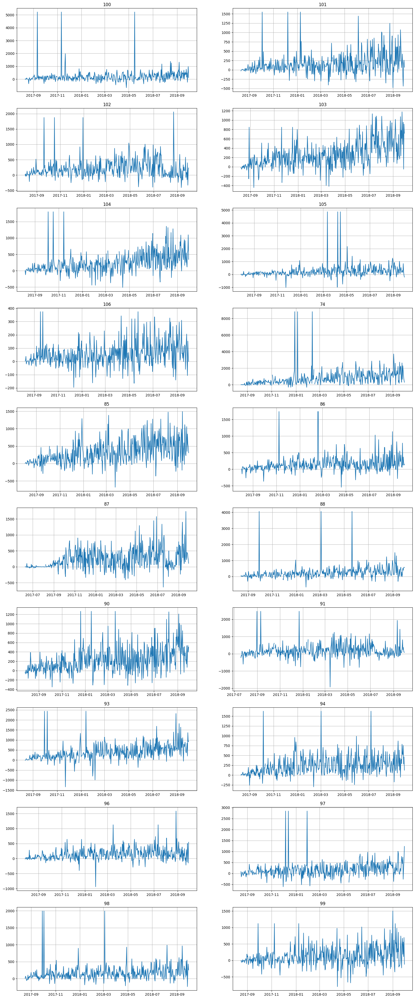

In [ ]:
ts.plot(n_segments = 20)

Начнем с визуального анализа временных рядов. Будем по очереди рассматривать каждый банкомат.

Про все ряды: наблюдаем сезоннось, на таком масштабе не понятно какую, но скорее всего - недельную

`100` - дисперсия растет со временем, есть слабый восходящий тренд, выбросы - не стационарен

`101`: видим что ряд точно не стационарный, так как дисперсия растет. Наблюдается очень слабовыраженный восходящий тренд. Видим несколько явных выбросов, вроде как непериодичных

`102`: ряд не стационарен по аналогичной причине, так же наблюдаются выбросы. Тренда как будто бы нет вовсе, либо он еще менее слабо выражен.

`103` в этом ряде дисперсия +- одинаковая на протяжении всего времени. Каких то явных выбросов не наблюдаю. Имеется более ярко выраженный восходящий тренд - ряд не стационарен

`104` дисперсия растет со временем, есть восходящий тренд, выбросы - не стационарен

`105` - дисперсия растет со временем, есть слабый восходящий тренд, выбросы - не стационарен

`106` дисперсия растет со временем, есть не сильно выраженный восходящий тренд, выбросы - не стационарен

`74` - дисперсия растет со временем, есть восходящий тренд, выбросы - не стационарен

`85` - дисперсия растет со временем, есть восходящий тренд - не стационарен

`86` - дисперсия растет со временем, есть слабый восходящий тренд, выбросы - не стационарен

`87` - дисперсия растет со временем, есть восходящий тренд - не стационарен

`88` - дисперсия растет со временем, есть слабый восходящий тренд, выбросы - не стационарен

`90` - дисперсия растет со временем, есть восходящий тренд - не стационарен

`91` -  дисперсия растет со временем, есть слабый восходящий тренд, выбросы - не стационарен

`92-99` -  дисперсия растет со временем, есть восходящий тренд, выбросы - не стационарен




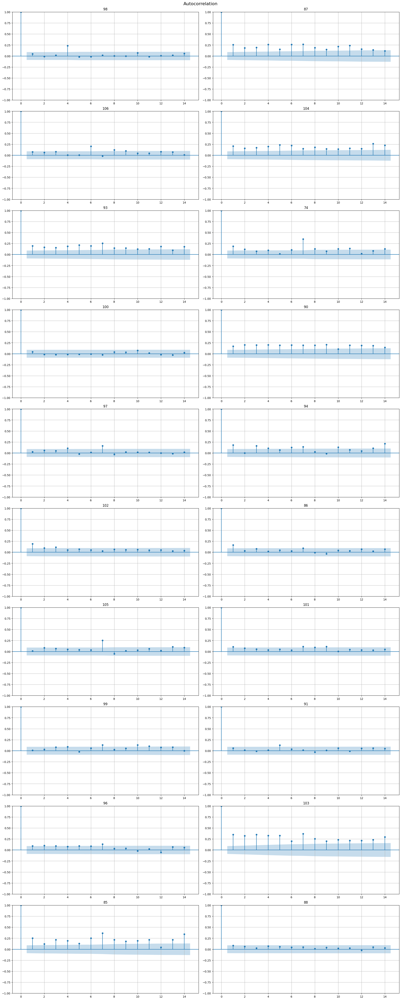

In [ ]:
acf_plot(ts, lags=14, n_segments = 20)

во всех рядах кроме `102, 88 и 100` есть значения ACF, отличные от 1 лага, значимы - визуальные подозрения о нестациионарности рядов подтвердились. 100 и 102 действительно выглядят стационарнее других, практически отсутствует тренд и особо не раздувает дисперсию. А вот 88 не такой. Дисперсия раздувается, тренд какой никакой наблюдается, но ладно.

По всем ACF пики наблюдаем в среднем на первом и седьмых лагах(недельная сезонность), иногда на 4-5 - это может говорить о том, что в этих рядах 4-5-дневная сезонность вместо недельной.

In [ ]:
#acf_plot(ts, partial=True, lags=21) # ломается xD потом выведу когда пропуски обработаем по плану хз зачем но ладно

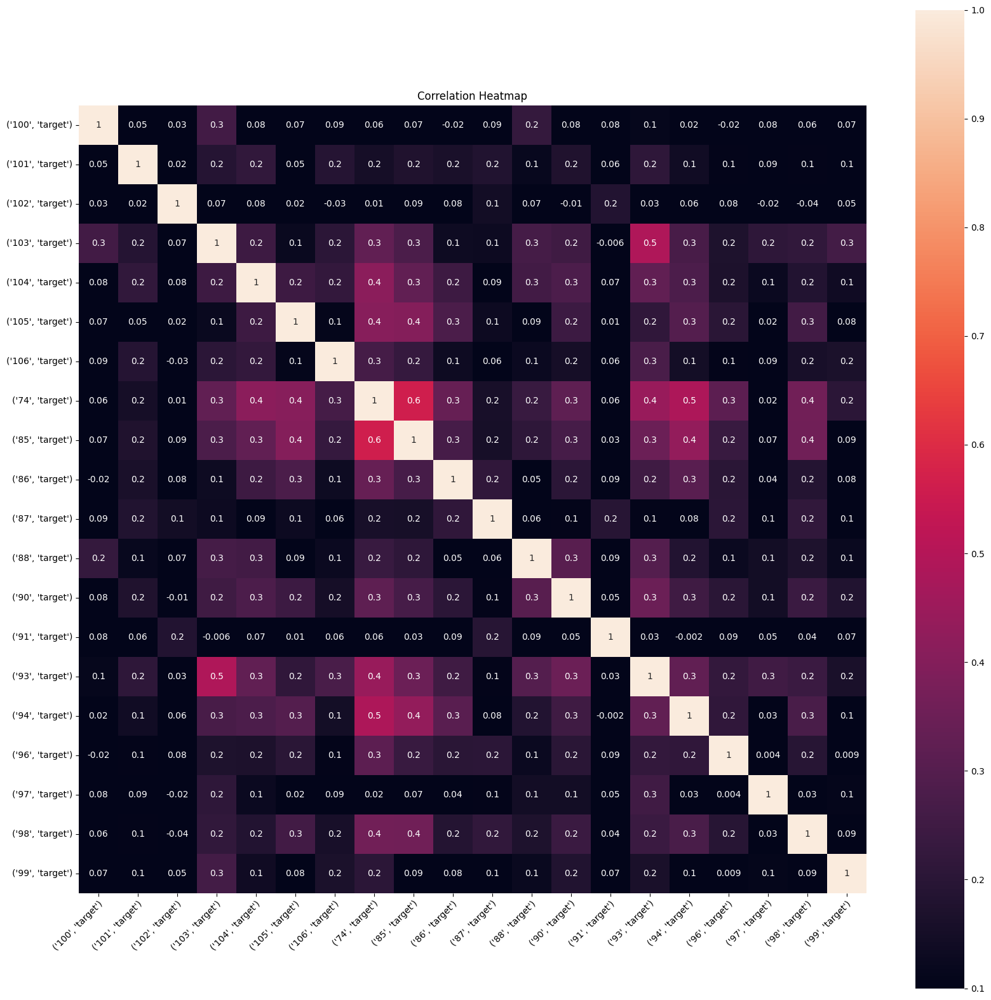

In [ ]:
plot_correlation_matrix(ts, method="spearman", vmin=0.1, vmax=1, figsize = (20, 20))

наблюдаем корреляцию только между большим число банкоматов

In [ ]:
segs = list(data["segment"].unique())

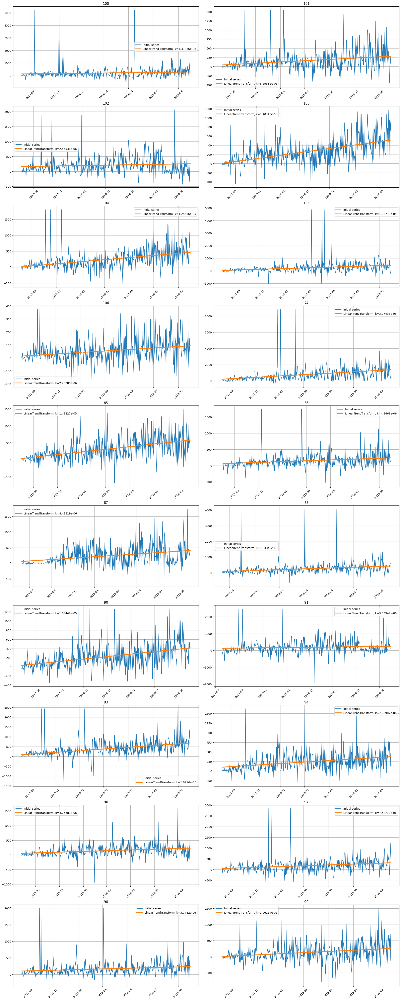

In [ ]:
trends = [
    LinearTrendTransform(in_column="target", poly_degree=1)
]
plot_trend(ts, trend_transform=trends)

Подтверждаем визуальный анализ ряда

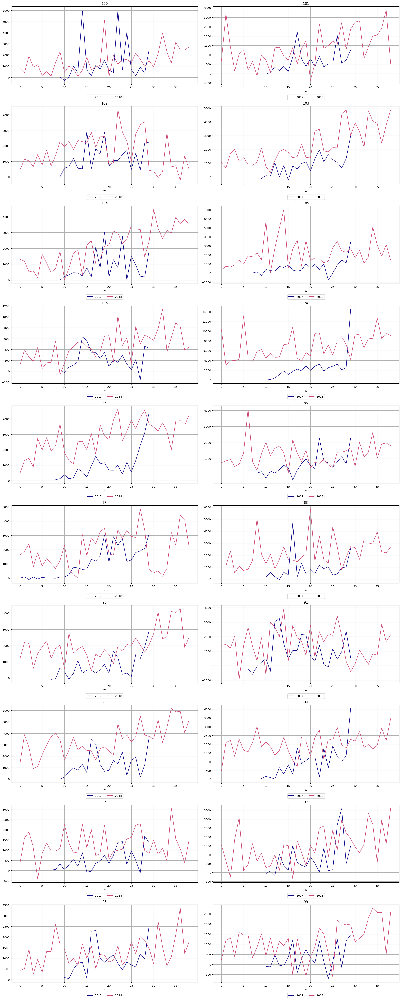

In [ ]:
from etna.analysis import seasonal_plot
seasonal_plot(ts=ts, freq='w')

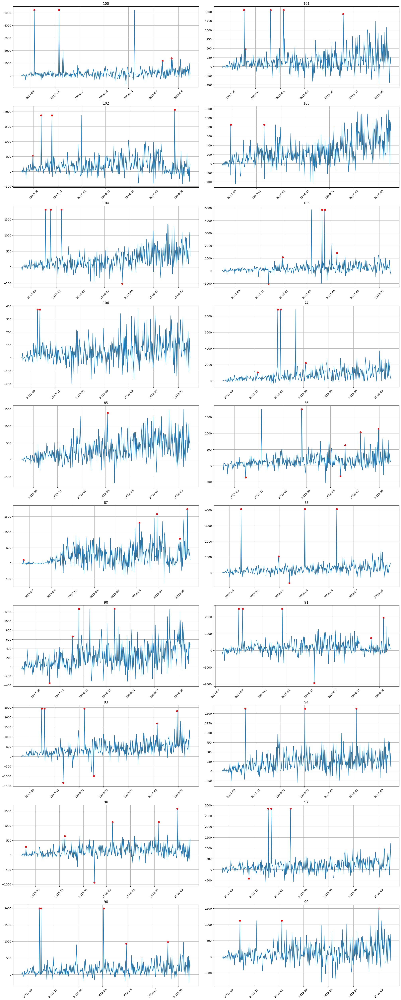

In [ ]:
anomaly_dict = get_anomalies_median(ts, window_size=30)
plot_anomalies(ts, anomaly_dict)

я бы и сам это отметить мог 🤗

все что мог с нанами из доки сделал

### 2. Работа с пропущенными значениями и выбросами


In [ ]:
ts.info()

<class 'etna.datasets.TSDataset'>
num_segments: 20
num_exogs: 0
num_regressors: 0
num_known_future: 0
freq: D
         start_timestamp end_timestamp  length  num_missing
segments                                                   
100           2017-08-11    2018-09-30     416            3
101           2017-08-11    2018-09-30     416            3
102           2017-08-02    2018-09-30     425            3
103           2017-08-08    2018-09-30     419            3
104           2017-08-07    2018-09-30     420            3
105           2017-07-28    2018-09-30     430            3
106           2017-08-09    2018-09-30     418            3
74            2017-08-16    2018-09-30     411            3
85            2017-08-03    2018-09-30     424            3
86            2017-08-01    2018-09-30     426            3
87            2017-06-09    2018-09-30     479            3
88            2017-08-14    2018-09-30     413            3
90            2017-07-27    2018-09-30     431    

In [ ]:
data[~data.notna().all(axis=1)]["timestamp"].unique()

array(['2017-11-02T00:00:00.000000000', '2018-02-16T00:00:00.000000000',
       '2018-05-06T00:00:00.000000000', '2017-10-06T00:00:00.000000000',
       '2017-11-09T00:00:00.000000000', '2018-05-09T00:00:00.000000000',
       '2017-08-02T00:00:00.000000000', '2017-08-19T00:00:00.000000000',
       '2017-12-01T00:00:00.000000000', '2017-08-07T00:00:00.000000000',
       '2018-03-03T00:00:00.000000000', '2018-03-11T00:00:00.000000000',
       '2017-10-19T00:00:00.000000000', '2017-10-21T00:00:00.000000000',
       '2017-11-27T00:00:00.000000000', '2017-10-23T00:00:00.000000000',
       '2018-02-02T00:00:00.000000000', '2018-02-12T00:00:00.000000000',
       '2017-10-17T00:00:00.000000000', '2018-01-12T00:00:00.000000000',
       '2018-01-16T00:00:00.000000000', '2017-12-25T00:00:00.000000000',
       '2018-01-03T00:00:00.000000000', '2018-01-04T00:00:00.000000000',
       '2017-10-12T00:00:00.000000000', '2018-01-06T00:00:00.000000000',
       '2018-04-05T00:00:00.000000000', '2017-09-28

по 3 выброса для каждого банкомата, разные даты, видимо сделали специально рандомное удаление

Будем заполнять с помощью TimeSeriesImputerTransform. Есть следующие способы заполнения:

If “mean”, then replace missing dates using the mean in fit stage.

If “running_mean” then replace missing dates using mean of subset of data

If “forward_fill” then replace missing dates using last existing value

If “seasonal” then replace missing dates using seasonal moving average in autoregressive manner, point are imputed one by one in time order, already imputed points are used to impute the next points

If “seasonal_nonautoreg” then replace missing dates using seasonal moving average of existing values, all points are imputed using only existing points

If “constant” then replace missing dates using constant value.

Методом исключения: mean - слишком просто, не учтет то что в разные периоды по разному себя ведет, forward_fill - очевидно не очень, constant - мб и можно но врядли, для каждого банкомата отдельно подбирать надо

Можно взять сезонный способ, т.к. присутствует сезонность

In [ ]:
# imputer = TimeSeriesImputerTransform(strategy='running_mean', window=30) #30 - месяц
imputer = TimeSeriesImputerTransform(strategy='seasonal', seasonality=7)
ts.fit_transform([imputer])
ts.info()

<class 'etna.datasets.TSDataset'>
num_segments: 20
num_exogs: 0
num_regressors: 0
num_known_future: 0
freq: D
         start_timestamp end_timestamp  length  num_missing
segments                                                   
100           2017-08-11    2018-09-30     416            0
101           2017-08-11    2018-09-30     416            0
102           2017-08-02    2018-09-30     425            0
103           2017-08-08    2018-09-30     419            0
104           2017-08-07    2018-09-30     420            0
105           2017-07-28    2018-09-30     430            0
106           2017-08-09    2018-09-30     418            0
74            2017-08-16    2018-09-30     411            0
85            2017-08-03    2018-09-30     424            0
86            2017-08-01    2018-09-30     426            1
87            2017-06-09    2018-09-30     479            0
88            2017-08-14    2018-09-30     413            0
90            2017-07-27    2018-09-30     431    

Проверьте ряды на наличие выбросов, и очистите их соответствующим образом. Обоснуйте выбор.

уже видели как медианный справился, попробуем density

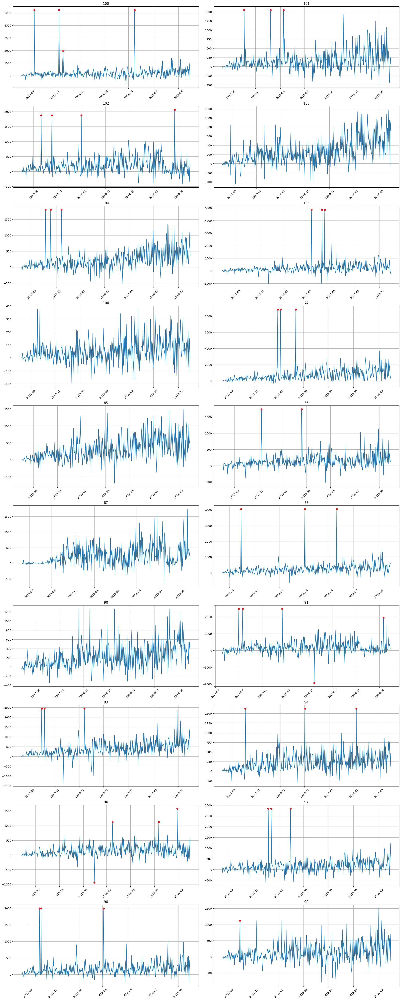

In [ ]:
anomaly_dict = get_anomalies_density(ts, window_size=30)
plot_anomalies(ts, anomaly_dict)

МБ нужно потюнить, но медианный все таки лучше справился, юзанем его

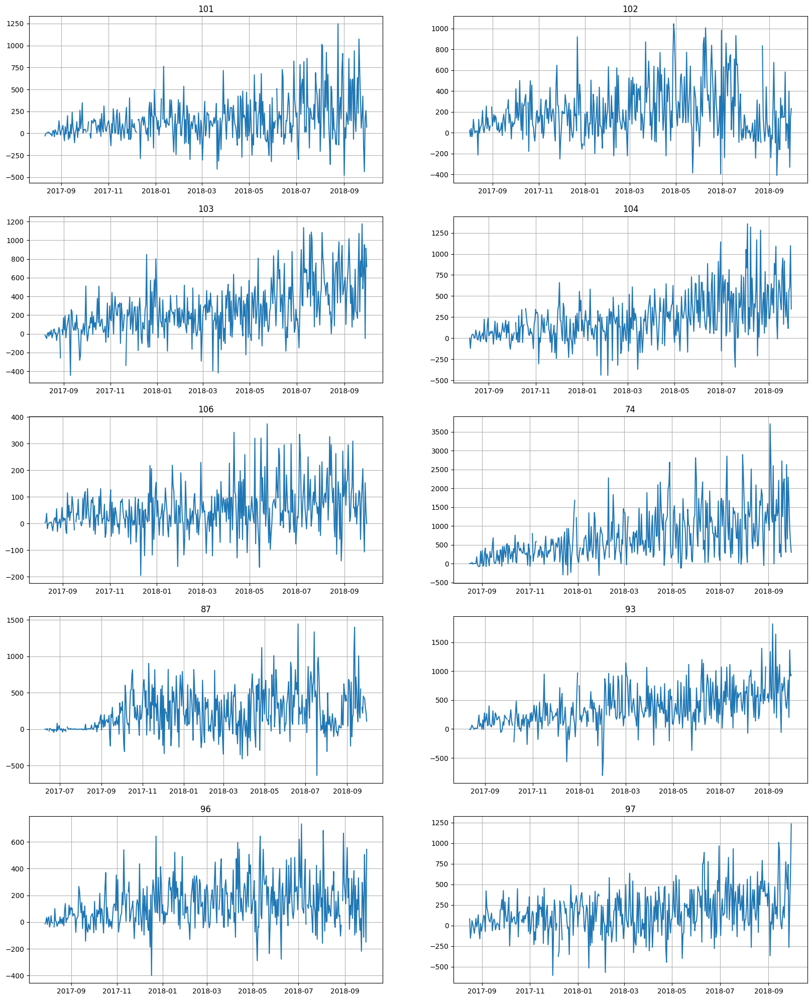

In [ ]:
outlier_transform = MedianOutliersTransform(in_column='target', window_size=30)
ts.fit_transform([outlier_transform])
ts.plot()

а зачем мы сначала убрали выбросы а потом их добавили в чем прикол???

In [ ]:
ts.fit_transform([imputer])
ts.describe()

,start_timestamp,end_timestamp,length,num_missing,num_segments,num_exogs,num_regressors,num_known_future,freq
segments,,,,,,,,,
100,2017-08-11,2018-09-30,416,0,20,0,0,0,D
101,2017-08-11,2018-09-30,416,0,20,0,0,0,D
102,2017-08-02,2018-09-30,425,0,20,0,0,0,D
103,2017-08-08,2018-09-30,419,0,20,0,0,0,D
104,2017-08-07,2018-09-30,420,0,20,0,0,0,D
105,2017-07-28,2018-09-30,430,0,20,0,0,0,D
106,2017-08-09,2018-09-30,418,0,20,0,0,0,D
74,2017-08-16,2018-09-30,411,0,20,0,0,0,D
85,2017-08-03,2018-09-30,424,0,20,0,0,0,D


Импутер не справился с некоторыми пропусками, видимо это особенность сезонного импутера.

In [ ]:
imputer_2 = TimeSeriesImputerTransform(strategy='running_mean', window=30)
ts.fit_transform([imputer_2])
ts.info()

<class 'etna.datasets.TSDataset'>
num_segments: 20
num_exogs: 0
num_regressors: 0
num_known_future: 0
freq: D
         start_timestamp end_timestamp  length  num_missing
segments                                                   
100           2017-08-11    2018-09-30     416            0
101           2017-08-11    2018-09-30     416            0
102           2017-08-02    2018-09-30     425            0
103           2017-08-08    2018-09-30     419            0
104           2017-08-07    2018-09-30     420            0
105           2017-07-28    2018-09-30     430            0
106           2017-08-09    2018-09-30     418            0
74            2017-08-16    2018-09-30     411            0
85            2017-08-03    2018-09-30     424            0
86            2017-08-01    2018-09-30     426            0
87            2017-06-09    2018-09-30     479            0
88            2017-08-14    2018-09-30     413            0
90            2017-07-27    2018-09-30     431    

### Построение Prophet

Постройте прогнозы с помощью Prophet и `etna.Pipeline`, под капотом `etna.Pipeline` обучит `ProphetModel` для каждого сегмента в отдельности. После этого оцените качество по SMAPE на кросс-валидации. В качестве горизонта предсказания возьмите 5 дней - этого же горизонта будем придерживаться и в дальнейшем.

Отрисуйте получившийся прогноз.

In [ ]:
HORIZON = 5
# transforms = [log, trend, lags, d_flags, seg, mean30]

In [ ]:
# train_ts, test_ts = ts.train_test_split(test_size=HORIZON)
model = ProphetModel()

# pipeline = Pipeline(model=model, horizon=HORIZON)
# pipeline.fit(train_ts)

metrics, forecast_df, test_df = pipeline.backtest(ts, metrics=[SMAPE(), MAE()], n_folds=3, aggregate_metrics=True)
forecast_ts = pipeline.forecast(ts)

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpevdtnwfp/mvjbsg9u.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpevdtnwfp/4yjr56ih.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=28897', 'data', 'file=/tmp/tmpevdtnwfp/mvjbsg9u.json', 'init=/tmp/tmpevdtnwfp/4yjr56ih.json', 'output', 'file=/tmp/tmpevdtnwfp/prophet_modelpst3c9e_/prophet_model-20240526100531.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
10:05:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
10:05:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling yearly seasonalit

<Axes: xlabel='segment'>

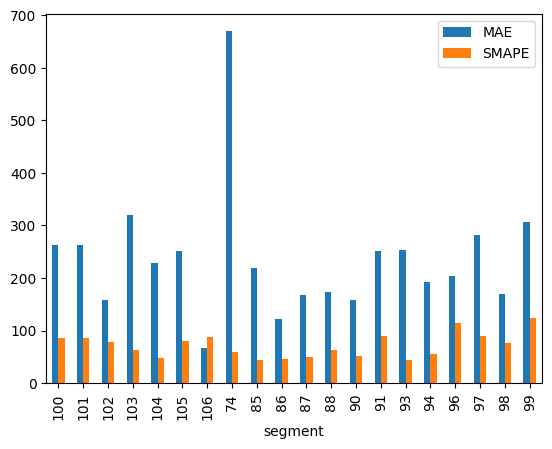

In [ ]:
metrics.plot.bar('segment',['MAE','SMAPE'])

Выведем средние метрики для сравнения со следующими моделями

In [ ]:
print(f'Mean SMAPE: {metrics["SMAPE"].mean()}')
print(f'Mean MAE: {metrics["MAE"].mean()}')

Mean SMAPE: 71.9146970719316
Mean MAE: 236.0916397464338


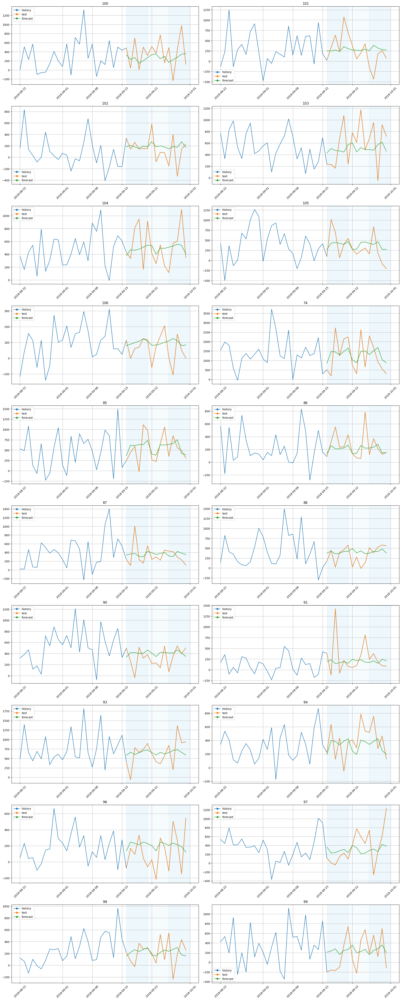

In [ ]:
plot_backtest(forecast_df=forecast_df, ts=ts, history_len=HORIZON*5)

Исходя из статистики по каждому ряду, какой можно сделать вывод о том, как лучше предсказывать итоговое значение? Посчитайте то же самое исходя из MAE.


качество получилось не очень, средний SMAPE = 72%, многовато. Сравнив метрики по каждому сегменту, можно сделать вывод, что иногда SMAPE и MAE дают разные результаты, если ранжировать качество прогнозов на сегнметах.


но хочется подметить что очень просто профетом пользоваться, "из коробки" хорошо работает, относительно следующих методов, которые я буду юзать.

### Построение признаков


In [ ]:
from etna.analysis import acf_plot, stl_plot
from etna.ensembles import DirectEnsemble, StackingEnsemble, VotingEnsemble
from etna.models import (CatBoostMultiSegmentModel, CatBoostPerSegmentModel,
                         AutoARIMAModel)
from etna.transforms import STLTransform, LagTransform, SegmentEncoderTransform

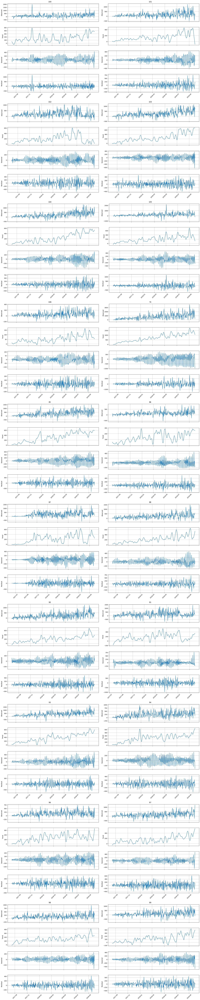

In [ ]:
#YOUR CODE HERE#
stl_plot(ts=ts, period=7)

In [ ]:
lags = LagTransform(in_column="target", lags=[5, 6, 7, 13, 14, 21], out_column="lag")
d_flags = DateFlagsTransform(
    day_number_in_week=True,
    day_number_in_month=True,
    week_number_in_month=True,
    week_number_in_year=True,
    month_number_in_year=True,
    year_number=True,
    special_days_in_week=[5, 6],
)
stl =  STLTransform(in_column="target", period=7, model="arima")
transforms_cat = [lags, stl, d_flags]
transforms_arima = [lags, d_flags]

In [ ]:
# train_ts, test_ts = ts.train_test_split(test_size=HORIZON)
pipeline_catmult = Pipeline(
    transforms=transforms_cat,
    model=CatBoostMultiSegmentModel(),
    horizon = HORIZON
)
metrics, forecast_df,  _ = pipeline_catmult.backtest(
    ts=ts, metrics=[SMAPE(), MAE()], aggregate_metrics=True, n_jobs = -1
)


[Parallel(n_jobs=-1)]: Using backend MultiprocessingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   45.0s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:   46.7s
[Parallel(n_jobs=-1)]: Done   3 out of   5 | elapsed:  1.5min remaining:   59.3s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  1.9min finished
[Parallel(n_jobs=-1)]: Using backend MultiprocessingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   17.5s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:   18.6s
[Parallel(n_jobs=-1)]: Done   3 out of   5 | elapsed:   29.6s remaining:   19.7s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   34.8s finished
[Parallel(n_jobs=-1)]: Using backend MultiprocessingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    2.7s
[Parallel(n_jobs=-1)]: Done   3 out of   5 | elapsed:    3.0s r

In [ ]:
print(f'Mean SMAPE: {metrics["SMAPE"].mean()}')
print(f'Mean MAE: {metrics["MAE"].mean()}')

Mean SMAPE: 97.21181068175754
Mean MAE: 358.2004164848537


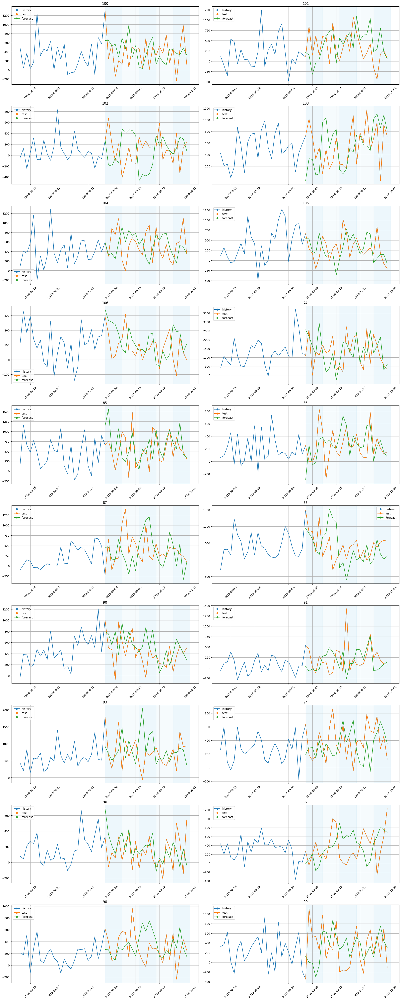

In [ ]:
# plot_forecast(forecast_ts, test_ts, train_ts, n_train_samples=10)
plot_backtest(forecast_df=forecast_df, ts=ts, history_len=HORIZON*5)

In [ ]:
# train_ts, test_ts = ts.train_test_split(test_size=HORIZON)
pipeline_catperseg = Pipeline(
    transforms=transforms_cat,
    model=CatBoostPerSegmentModel(),
    horizon = HORIZON
)
metrics, forecast_df,  _ = pipeline_catperseg.backtest(
    ts=ts, metrics=[SMAPE(), MAE()], aggregate_metrics=True, n_jobs = -1
)

[Parallel(n_jobs=-1)]: Using backend MultiprocessingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  3.5min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  3.5min
[Parallel(n_jobs=-1)]: Done   3 out of   5 | elapsed:  6.9min remaining:  4.6min
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  8.9min finished
[Parallel(n_jobs=-1)]: Using backend MultiprocessingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   13.5s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:   13.9s
[Parallel(n_jobs=-1)]: Done   3 out of   5 | elapsed:   25.8s remaining:   17.2s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   32.5s finished
[Parallel(n_jobs=-1)]: Using backend MultiprocessingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done   3 out of   5 | elapsed:    2.1s r

In [ ]:
print(f'Mean SMAPE: {metrics["SMAPE"].mean()}')
print(f'Mean MAE: {metrics["MAE"].mean()}')

Mean SMAPE: 99.44082076269851
Mean MAE: 359.9017920551971


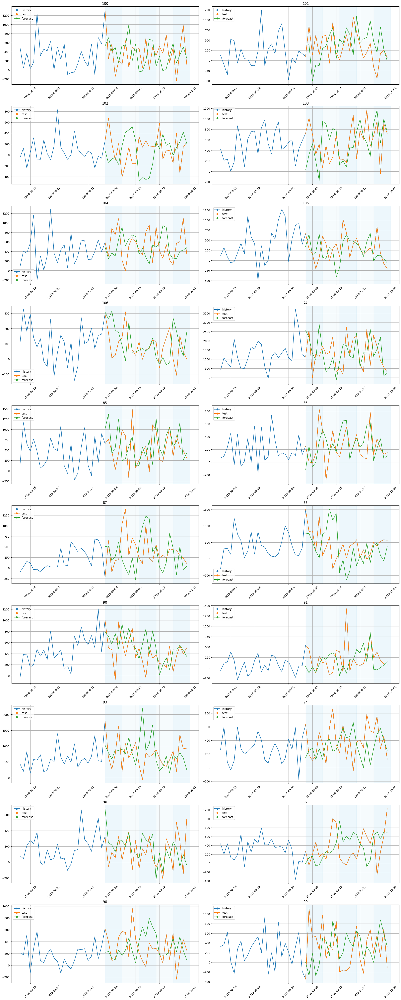

In [ ]:
# plot_forecast(forecast_ts, test_ts, train_ts, n_train_samples=10)
plot_backtest(forecast_df=forecast_df, ts=ts, history_len=HORIZON*5)

In [ ]:
# train_ts, test_ts = ts.train_test_split(test_size=HORIZON)
pipeline_arima = Pipeline(
    transforms=transforms_arima,
    model=AutoARIMAModel(),
    horizon = HORIZON
)
metrics, forecast_df,  _ = pipeline_arima.backtest(
    ts=ts, metrics=[SMAPE(), MAE()], aggregate_metrics=True, n_jobs = -1
)

[Parallel(n_jobs=-1)]: Using backend MultiprocessingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed: 22.3min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed: 23.0min
[Parallel(n_jobs=-1)]: Done   3 out of   5 | elapsed: 43.7min remaining: 29.1min
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 56.0min finished
[Parallel(n_jobs=-1)]: Using backend MultiprocessingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    6.6s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    7.7s
[Parallel(n_jobs=-1)]: Done   3 out of   5 | elapsed:   16.1s remaining:   10.7s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   19.7s finished
[Parallel(n_jobs=-1)]: Using backend MultiprocessingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done   3 out of   5 | elapsed:    1.9s r

In [ ]:
print(f'Mean SMAPE: {metrics["SMAPE"].mean()}')
print(f'Mean MAE: {metrics["MAE"].mean()}')

Mean SMAPE: 80.51947175371365
Mean MAE: 267.91436466112293


Арима неплоха но очень долго учится

In [ ]:
# plot_forecast(forecast_ts, test_ts, train_ts, n_train_samples=10)
plot_backtest(forecast_df=forecast_df, ts=ts, history_len=HORIZON*5)

### Ансамбли


In [ ]:
from etna.ensembles import StackingEnsemble, VotingEnsemble

In [ ]:
pipeline_names = ["catboost multi", "catboost per segment"] # была арима я ее убрал с ней 3 часа обучалось и колаб сдох
pipeline_catmult = Pipeline(
    transforms=transforms_cat,
    model=CatBoostMultiSegmentModel(),
    horizon = HORIZON
)

pipeline_catperseg = Pipeline(
    transforms=transforms_cat,
    model=CatBoostPerSegmentModel(),
    horizon = HORIZON
)
pipelines = [pipeline_catmult, pipeline_catperseg]

In [ ]:
voting_ensemble = VotingEnsemble(pipelines=pipelines, n_jobs=-1)
voting_ensamble_metrics, voting_forecast_df, _ = voting_ensemble.backtest(
    ts=ts,
    metrics=[MAE(), MSE(), SMAPE(), MAPE()],
    n_folds=3,
    aggregate_metrics=True,
    n_jobs=-1,
)

voting_ensamble_metrics

[Parallel(n_jobs=-1)]: Using backend MultiprocessingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   34.2s
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   34.5s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  3.5min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  3.5min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  3.5min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  3.5min
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  3.5min
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   19.4s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:  5.5min finished
[Parallel(n_jobs=-1)]: Using backend MultiprocessingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   11.5s
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   10.2s
[Parallel(n

,segment,MAE,MSE,SMAPE,MAPE
0,100,331.777312,154583.044263,114.290273,1.724993e+18
1,101,376.605816,209146.186749,93.965952,3.703545e+18
2,102,351.319614,178732.624901,143.086330,3.869218e+18
3,103,259.867091,121211.442533,51.195633,4.699500e+18
4,104,323.214661,155448.469126,67.617682,8.236237e+01
5,105,250.031093,101948.425939,96.169401,1.002866e+18
6,106,103.442583,18532.750977,117.578061,3.056391e+18
7,74,786.019426,993283.964959,64.708025,1.462217e+02
8,85,298.589682,155953.197580,63.478112,4.608691e+18
9,86,177.883553,48239.905292,76.719277,1.494490e+02


In [ ]:
voting_ensamble_metrics.mean(axis = 0)

segment    5.005055e+44
MAE        3.335206e+02
MSE        2.043522e+05
SMAPE      9.774980e+01
MAPE       4.108772e+18
dtype: float64

In [ ]:
plot_backtest(voting_forecast_df, ts)

In [ ]:
pipeline_names = ["catboost multi", "catboost per segment"] # была арима я ее убрал с ней 3 часа обучалось и колаб сдох
pipeline_catmult = Pipeline(
    transforms=transforms_cat,
    model=CatBoostMultiSegmentModel(),
    horizon = HORIZON
)

pipeline_catperseg = Pipeline(
    transforms=transforms_cat,
    model=CatBoostPerSegmentModel(),
    horizon = HORIZON
)
pipelines = [pipeline_catmult, pipeline_catperseg]
stacking_ensemble_unfeatured = StackingEnsemble(pipelines=pipelines, n_folds=3, n_jobs=-1)

In [ ]:
stacking_ensamble_metrics = stacking_ensemble_unfeatured.backtest(
    ts=ts,
    metrics=[MAE(), MSE(), SMAPE(), MAPE()],
    n_folds=3,
    aggregate_metrics=True,
    n_jobs=-1,
)

stacking_ensamble_metrics[0]

[Parallel(n_jobs=-1)]: Using backend MultiprocessingBackend with 2 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:   32.6s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:   32.9s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:  1.1min
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:  1.1min
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:  1.6min
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:  1.6min
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:  1.6min
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:  1.6min
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    8.3s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    9.0s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   19.7s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   20.2s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:   29.3s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:   29.3s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.1

,segment,MAE,MSE,SMAPE,MAPE
0,100,264.407323,108091.451303,77.725245,2.075296e+18
1,101,293.816762,143358.106636,87.671984,4.509970e+18
2,102,239.655446,86001.654683,107.001602,6.284082e+18
3,103,263.238692,106221.273886,53.083708,3.166877e+18
4,104,263.105732,113521.900326,54.693281,6.605643e+01
5,105,244.971459,87702.690681,77.179001,3.291980e+18
6,106,215.545151,54846.627288,124.911929,7.570480e+18
7,74,778.635242,968102.465925,68.442775,8.889553e+01
8,85,242.700856,102786.137867,49.008705,3.761665e+18
9,86,175.996790,45898.474303,63.718306,1.552213e+02


In [ ]:
print(stacking_ensamble_metrics[0].mean(axis = 0))
plot_backtest(stacking_ensamble_metrics[1], ts)

stacking_ensemble сильно(относительно других методов, они вообще ухудшали) улучшил качество, обучался дольше всего